In [1]:
! pip install -q kaggle

In [2]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets list

ref                                                    title                                         size  lastUpdated          downloadCount  voteCount  usabilityRating  
-----------------------------------------------------  -------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
rahulvyasm/netflix-movies-and-tv-shows                 Netflix Movies and TV Shows                    1MB  2024-04-10 09:48:38          25032        532  1.0              
jainaru/thyroid-disease-data                           Thyroid Disease Data                           3KB  2024-05-10 12:06:31           3338         78  1.0              
girumwondemagegn/dataset-for-renewable-energy-systems  Dataset for renewable energy systems         853KB  2024-05-17 23:51:25           1095         32  1.0              
mayankanand2701/zomato-stock-price-dataset             Zomato Stock Price Dataset 📊🍗🏨🍴               13KB  2024-05-23 06:42:34            95

In [3]:
! kaggle datasets download -d iamsouravbanerjee/indian-food-images-dataset

Dataset URL: https://www.kaggle.com/datasets/iamsouravbanerjee/indian-food-images-dataset
License(s): other
100% 353M/355M [00:05<00:00, 84.7MB/s]
100% 355M/355M [00:05<00:00, 70.8MB/s]


In [4]:
import zipfile
zip_ref = zipfile.ZipFile('/content/indian-food-images-dataset.zip', 'r')
zip_ref.extractall('/content')
zip_ref.close()

In [5]:
import os

dataset_dir = '/content/Indian Food Images/Indian Food Images'
subdirectories = [d for d in os.listdir(dataset_dir) if os.path.isdir(os.path.join(dataset_dir, d))]
num_classes = len(subdirectories)
print("Number of classes:", num_classes)

print("Classes:")
for subdir in subdirectories:
    print(subdir)


Number of classes: 80
Classes:
palak_paneer
lyangcha
chicken_tikka_masala
lassi
chapati
sohan_halwa
anarsa
chicken_tikka
misti_doi
ghevar
butter_chicken
shankarpali
sheer_korma
mysore_pak
misi_roti
biryani
sutar_feni
rasgulla
imarti
adhirasam
poha
kuzhi_paniyaram
modak
poornalu
bhindi_masala
gavvalu
chak_hao_kheer
boondi
aloo_gobi
chicken_razala
pootharekulu
qubani_ka_meetha
malapua
sohan_papdi
rabri
kajjikaya
daal_baati_churma
navrattan_korma
kadhi_pakoda
double_ka_meetha
bandar_laddu
ariselu
dharwad_pedha
paneer_butter_masala
aloo_shimla_mirch
daal_puri
dal_makhani
dal_tadka
kachori
ledikeni
pithe
chikki
bhatura
aloo_matar
chana_masala
gulab_jamun
cham_cham
doodhpak
unni_appam
chhena_kheeri
maach_jhol
phirni
aloo_methi
aloo_tikki
kadai_paneer
jalebi
sandesh
sheera
dum_aloo
karela_bharta
kofta
makki_di_roti_sarson_da_saag
gajar_ka_halwa
basundi
ras_malai
litti_chokha
kakinada_khaja
kalakand
shrikhand
naan


Number of classes: 80

Class: palak_paneer


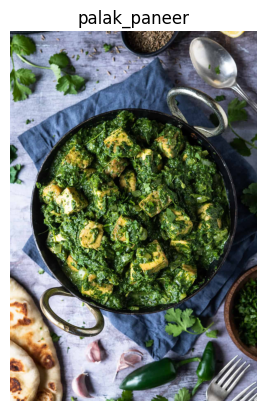


Class: lyangcha


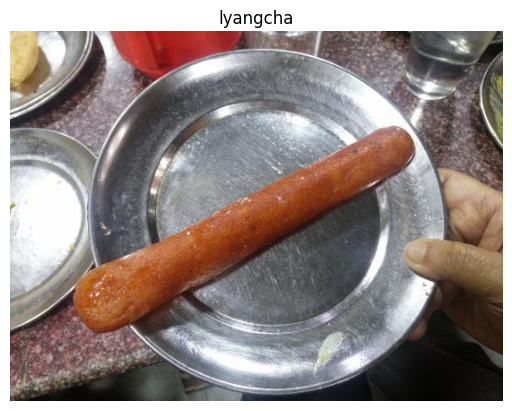


Class: chicken_tikka_masala


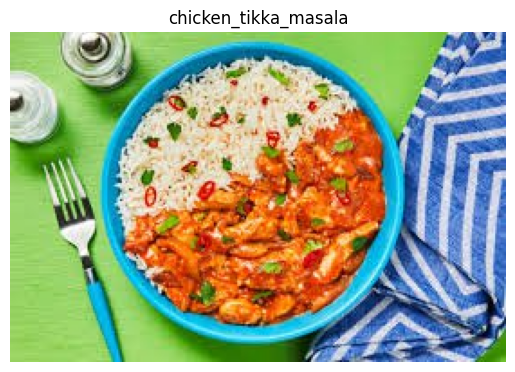


Class: lassi


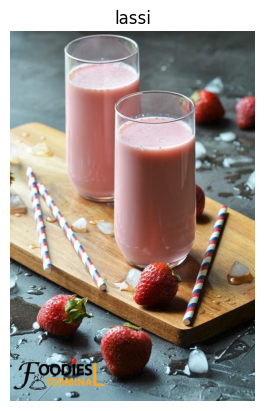


Class: chapati


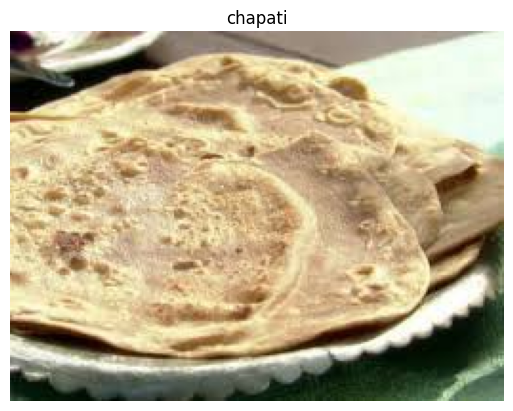


Class: sohan_halwa


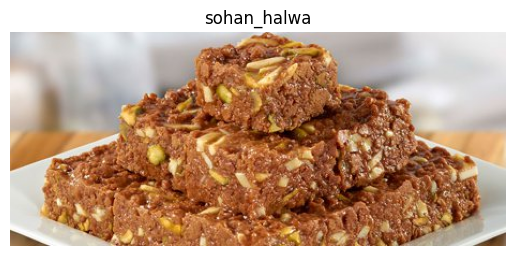


Class: anarsa


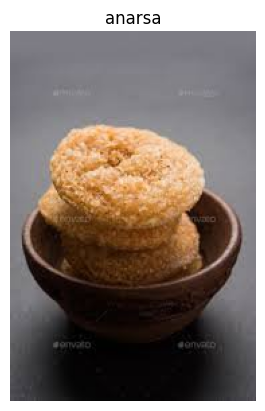


Class: chicken_tikka


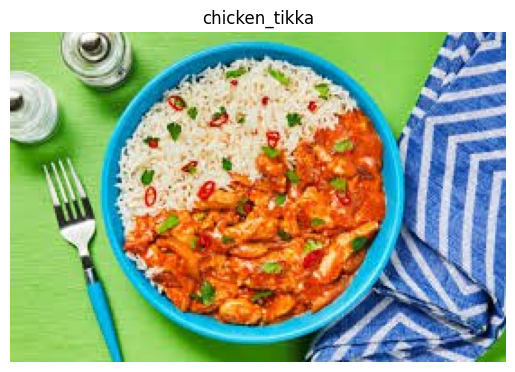


Class: misti_doi


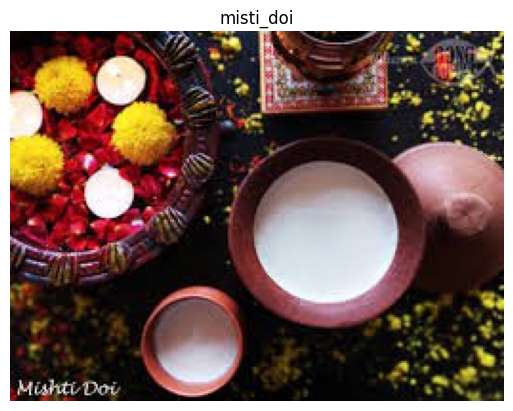


Class: ghevar


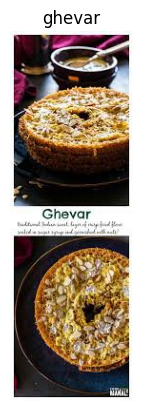


Class: butter_chicken


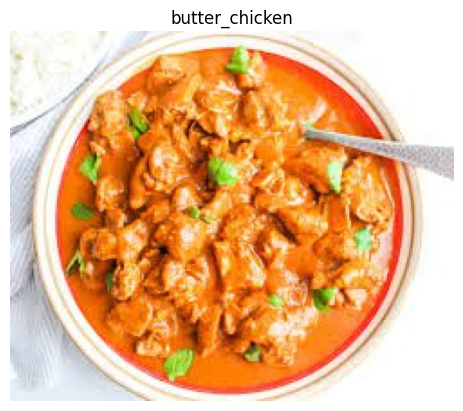


Class: shankarpali


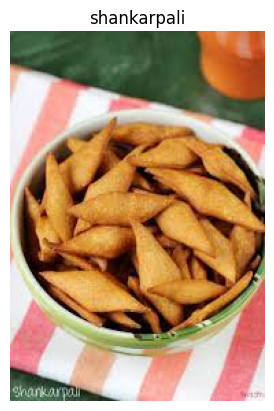


Class: sheer_korma


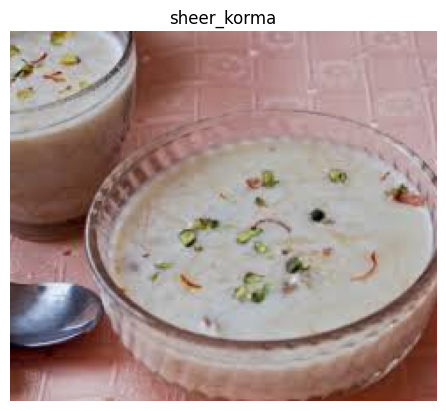


Class: mysore_pak


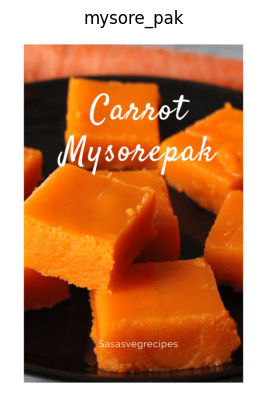


Class: misi_roti


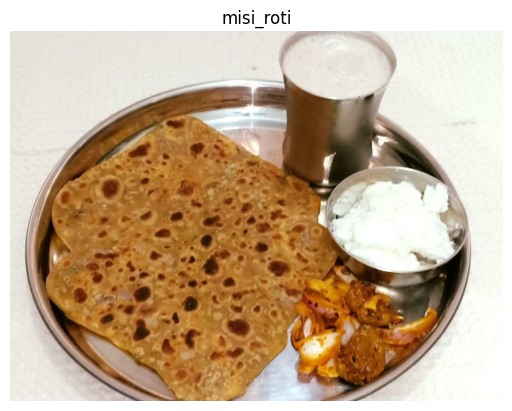


Class: biryani


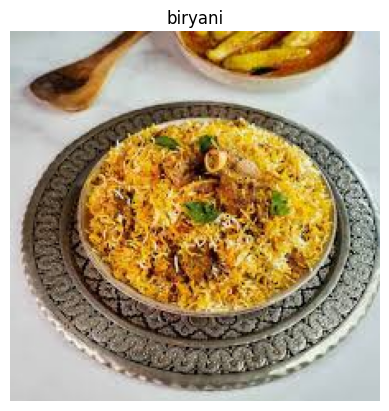


Class: sutar_feni


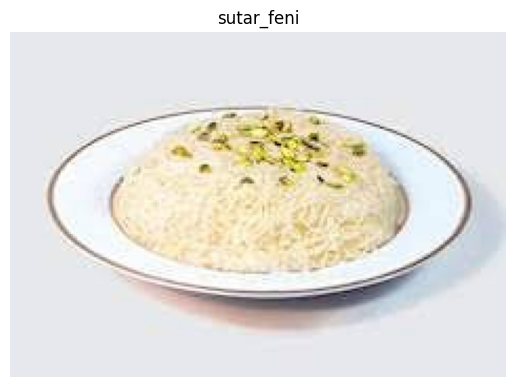


Class: rasgulla


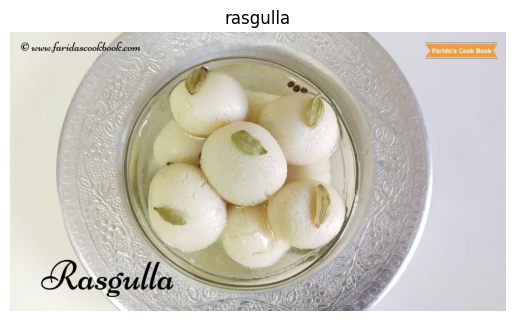


Class: imarti


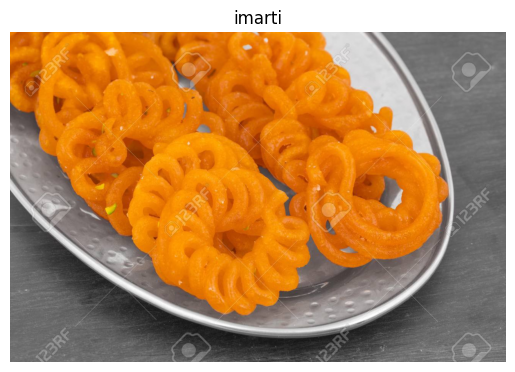


Class: adhirasam


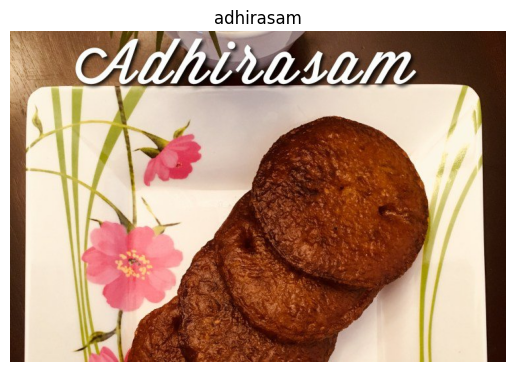


Class: poha


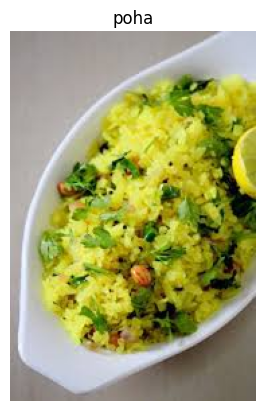


Class: kuzhi_paniyaram


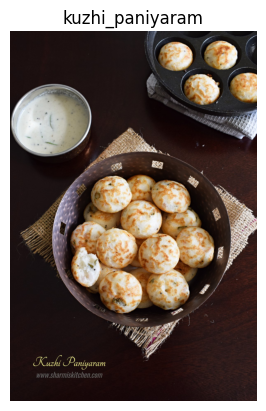


Class: modak


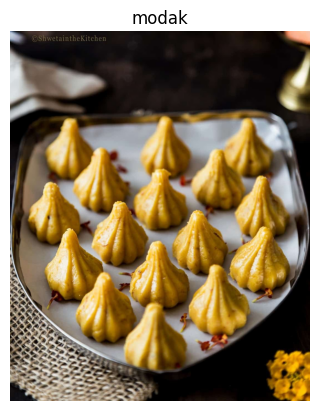


Class: poornalu


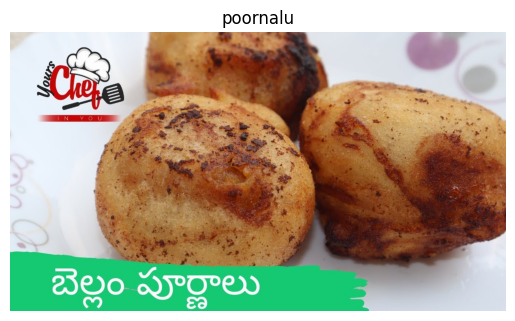


Class: bhindi_masala


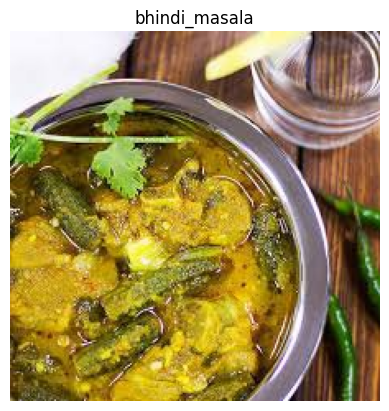


Class: gavvalu


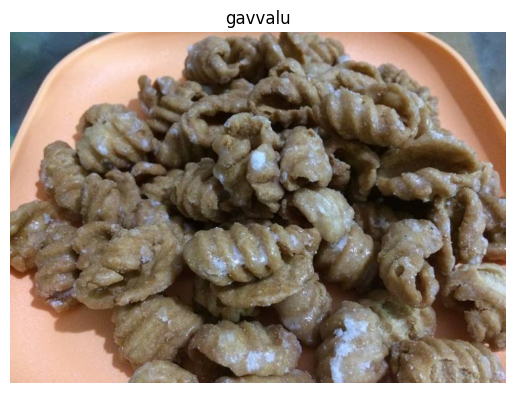


Class: chak_hao_kheer


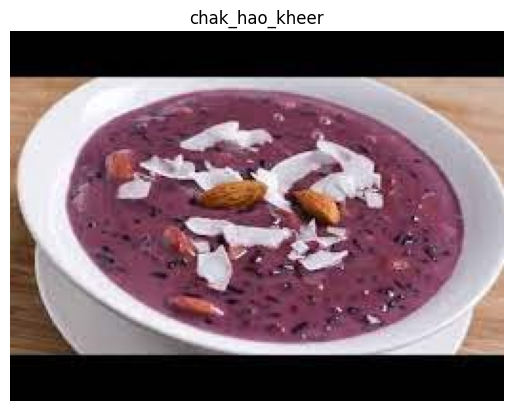


Class: boondi


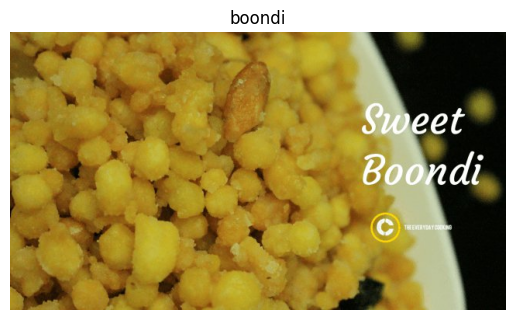


Class: aloo_gobi


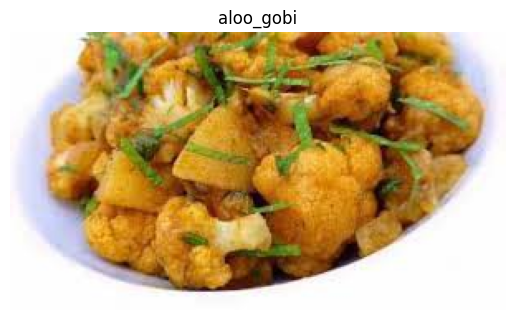


Class: chicken_razala


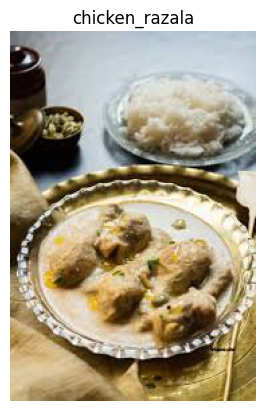


Class: pootharekulu


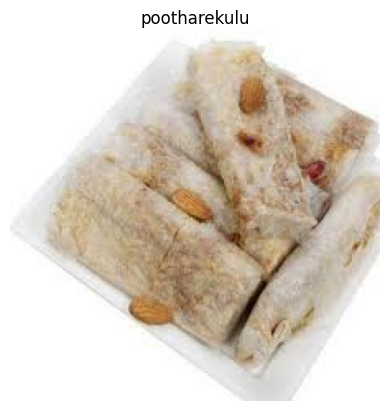


Class: qubani_ka_meetha


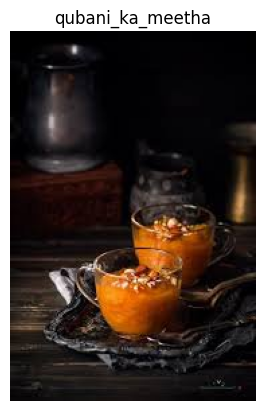


Class: malapua


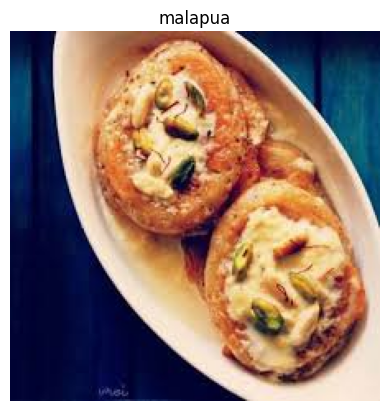


Class: sohan_papdi


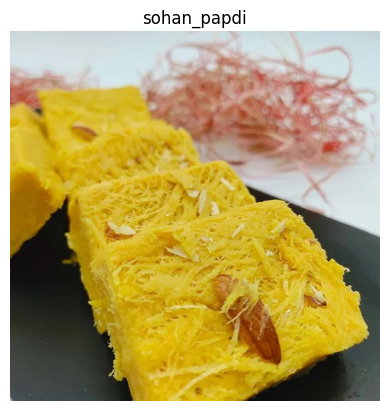


Class: rabri


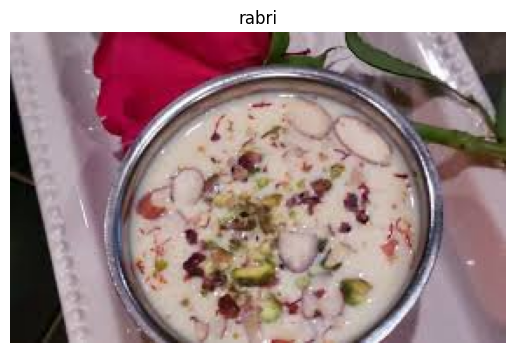


Class: kajjikaya


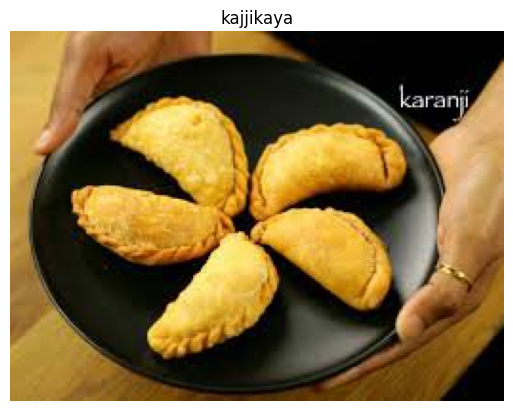


Class: daal_baati_churma


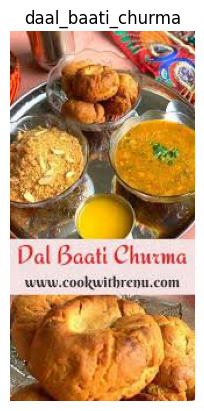


Class: navrattan_korma


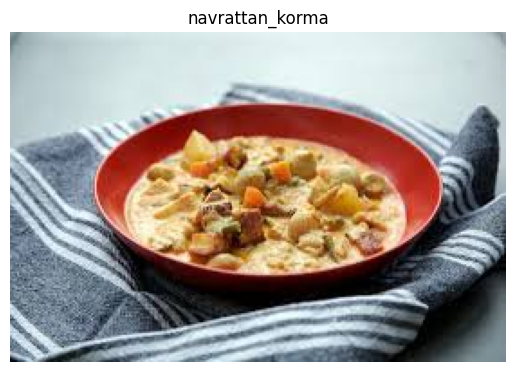


Class: kadhi_pakoda


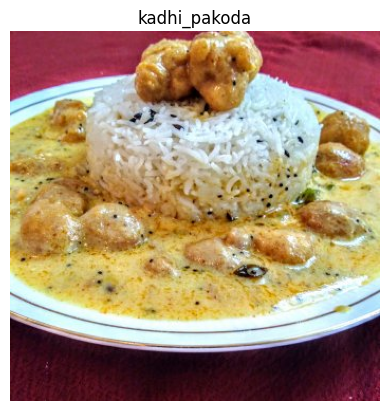


Class: double_ka_meetha


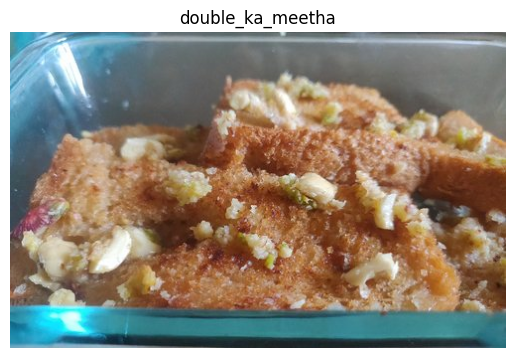


Class: bandar_laddu


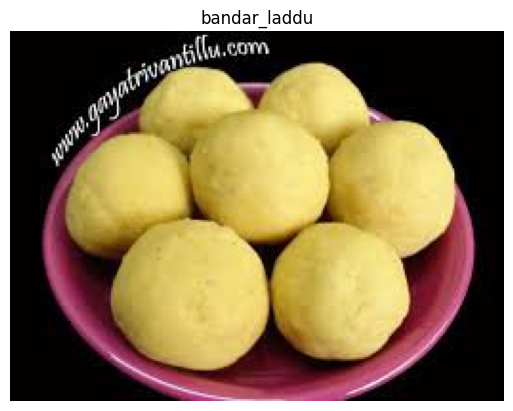


Class: ariselu


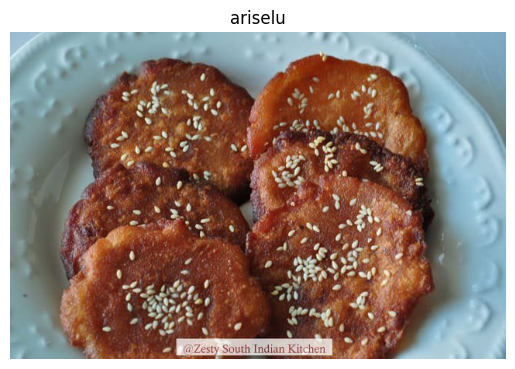


Class: dharwad_pedha


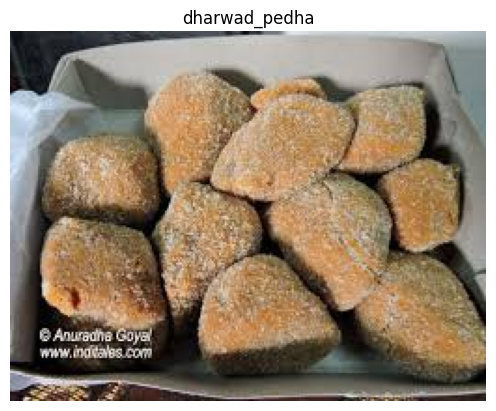


Class: paneer_butter_masala


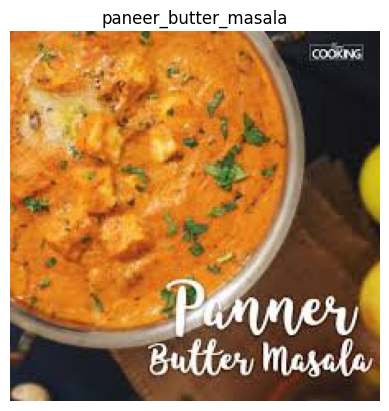


Class: aloo_shimla_mirch


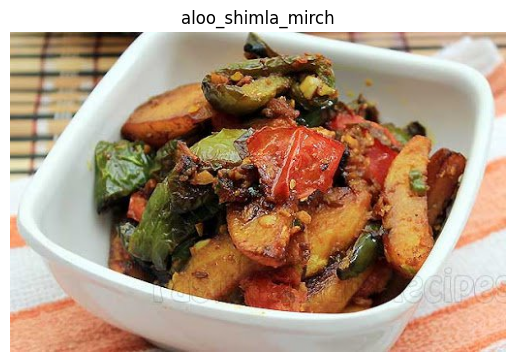


Class: daal_puri


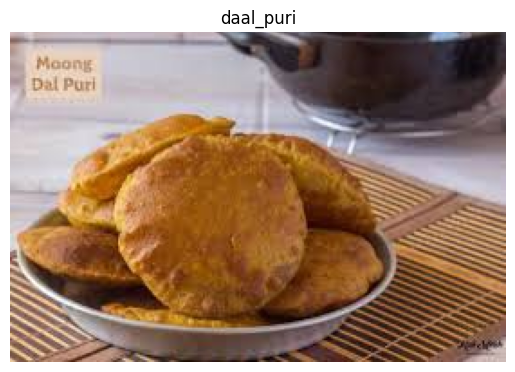


Class: dal_makhani


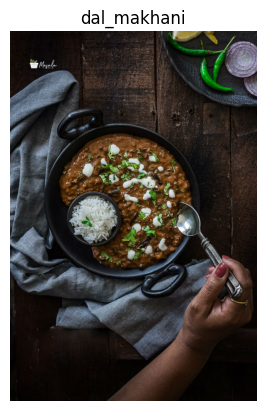


Class: dal_tadka


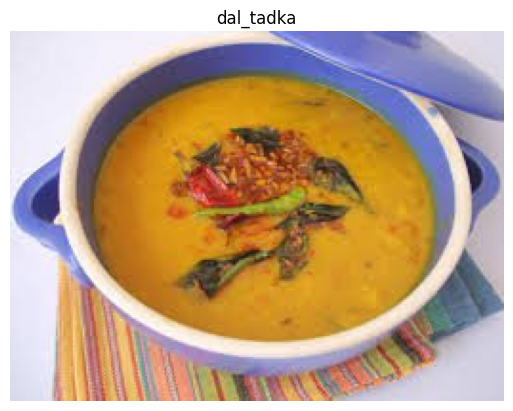


Class: kachori


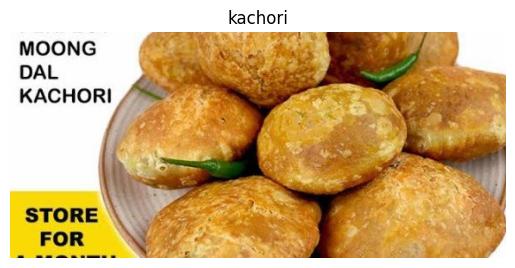


Class: ledikeni


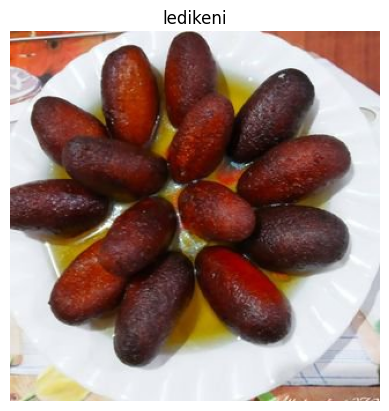


Class: pithe


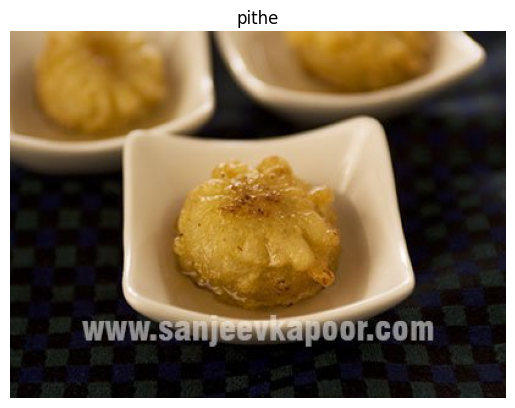


Class: chikki


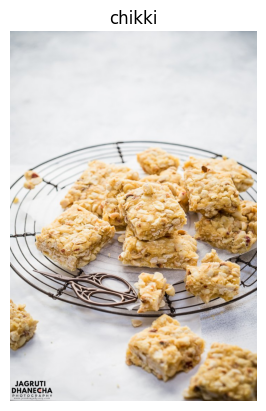


Class: bhatura


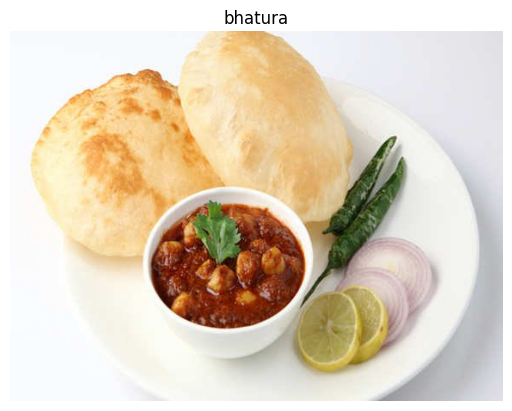


Class: aloo_matar


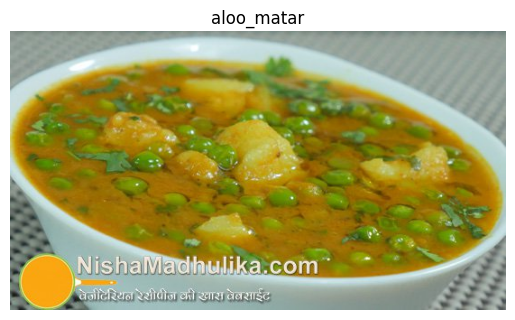


Class: chana_masala


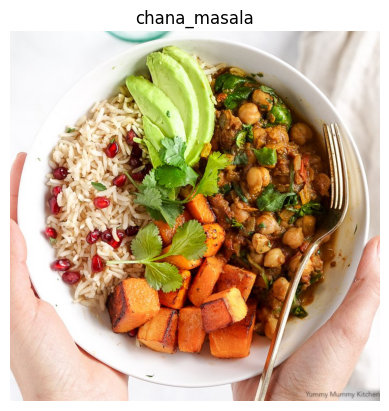


Class: gulab_jamun


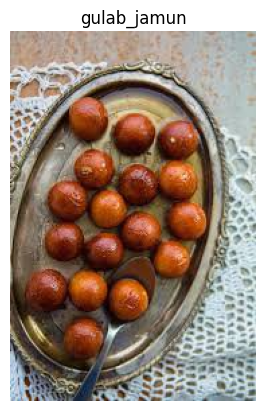


Class: cham_cham


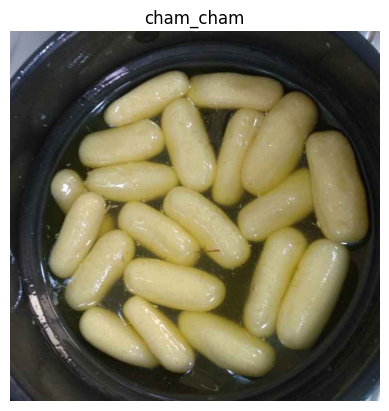


Class: doodhpak


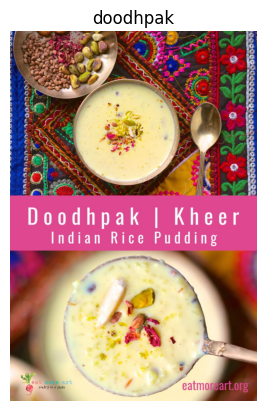


Class: unni_appam


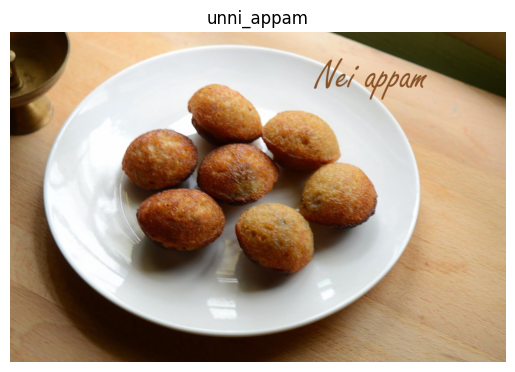


Class: chhena_kheeri


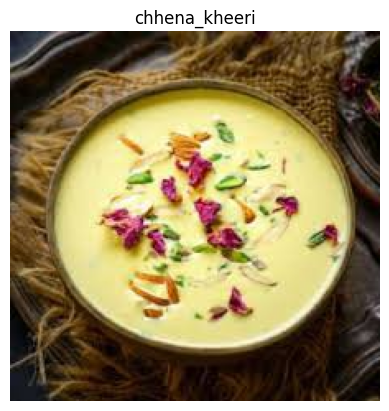


Class: maach_jhol


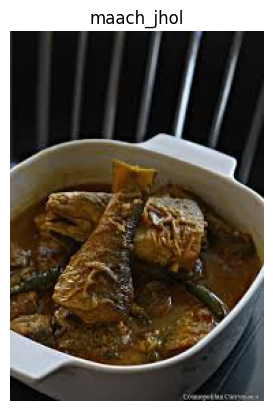


Class: phirni


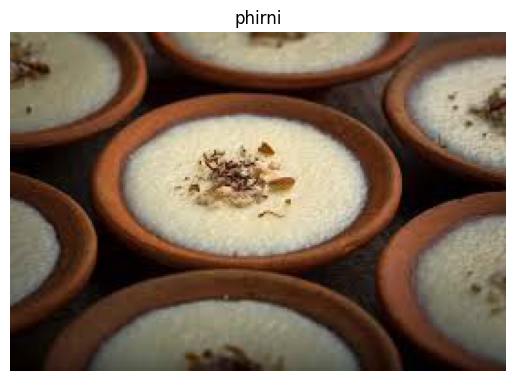


Class: aloo_methi


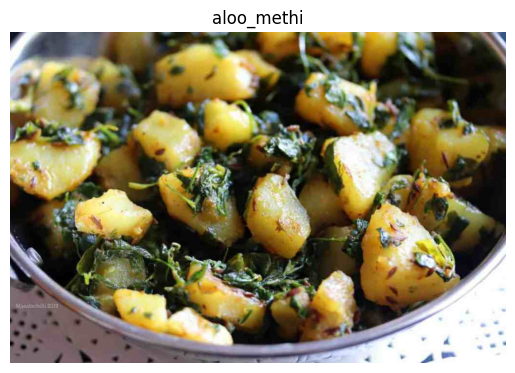


Class: aloo_tikki


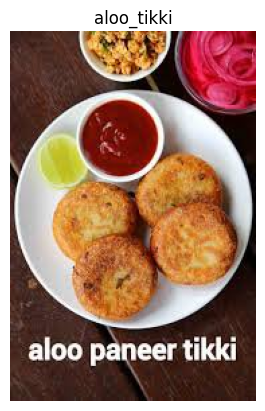


Class: kadai_paneer


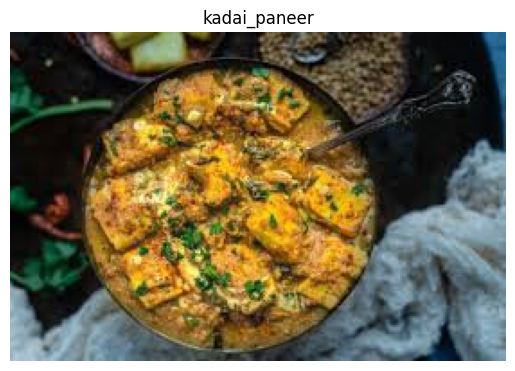


Class: jalebi


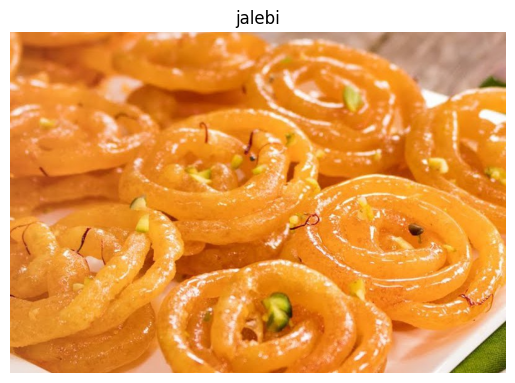


Class: sandesh


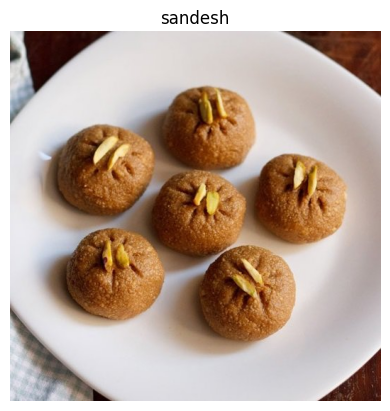


Class: sheera


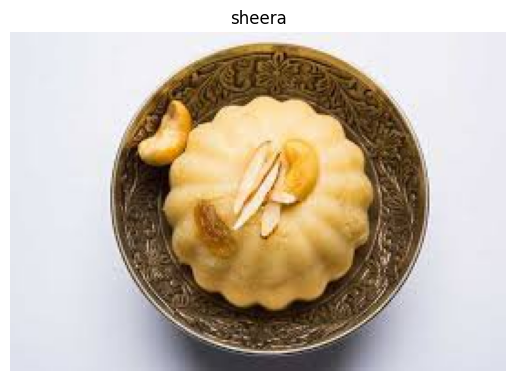


Class: dum_aloo


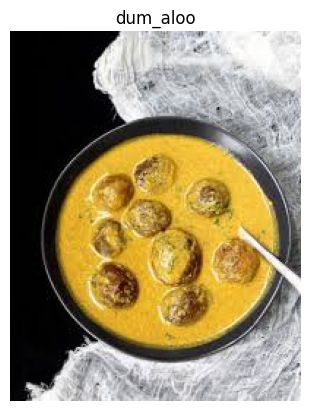


Class: karela_bharta


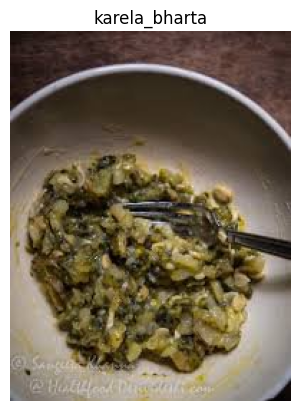


Class: kofta


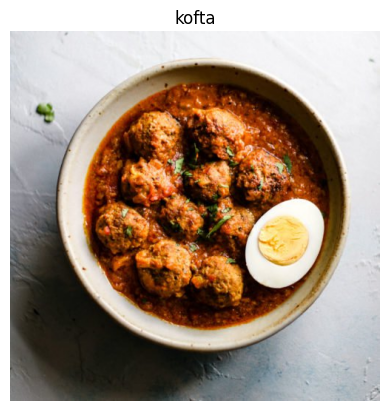


Class: makki_di_roti_sarson_da_saag


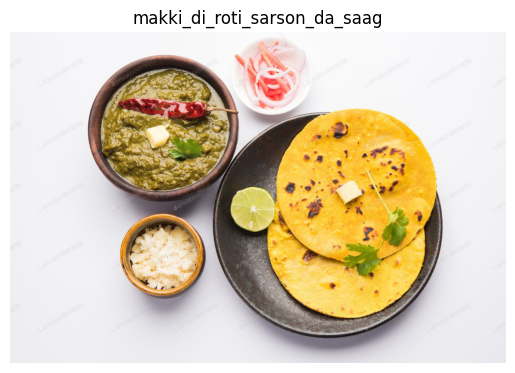


Class: gajar_ka_halwa


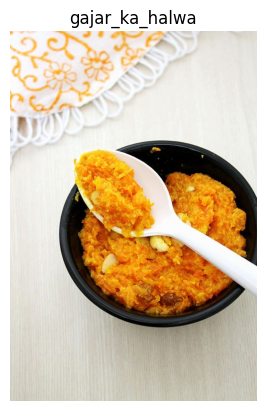


Class: basundi


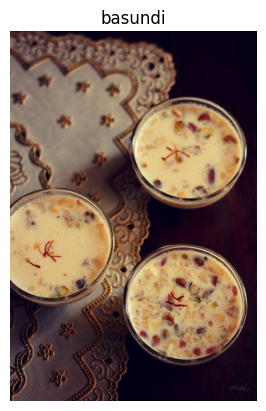


Class: ras_malai


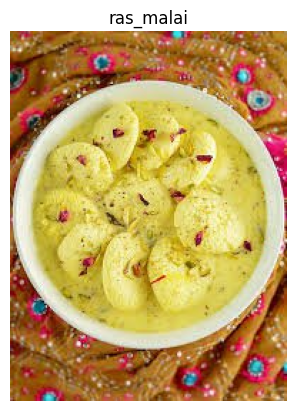


Class: litti_chokha


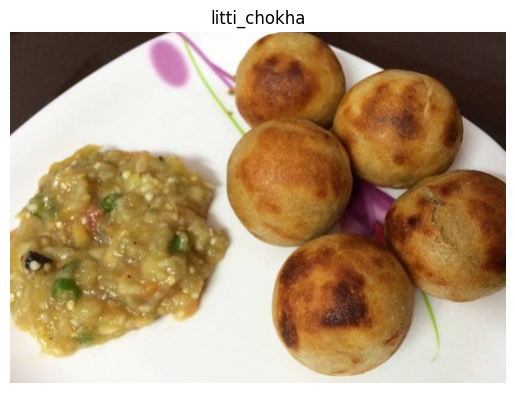


Class: kakinada_khaja


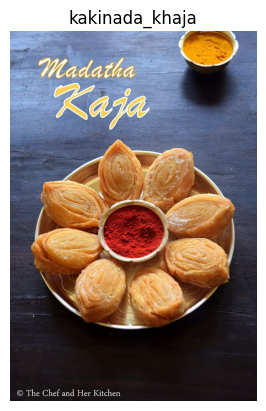


Class: kalakand


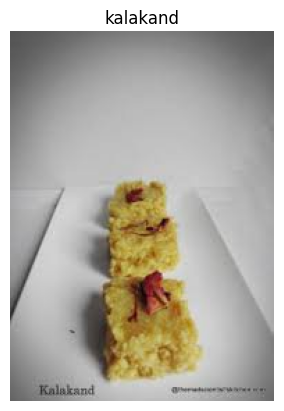


Class: shrikhand


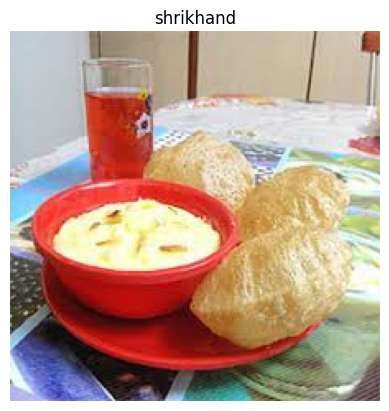


Class: naan


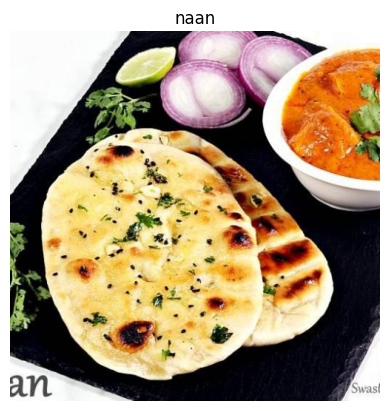

In [6]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

dataset_dir = '/content/Indian Food Images/Indian Food Images'

subdirectories = [d for d in os.listdir(dataset_dir) if os.path.isdir(os.path.join(dataset_dir, d))]

num_classes = len(subdirectories)
print("Number of classes:", num_classes)

num_samples_per_class = 1
for subdir in subdirectories:
    print("\nClass:", subdir)
    subdir_path = os.path.join(dataset_dir, subdir)
    filenames = os.listdir(subdir_path)
    sample_filenames = filenames[:num_samples_per_class]
    for filename in sample_filenames:
        img_path = os.path.join(subdir_path, filename)
        img = mpimg.imread(img_path)
        plt.imshow(img)
        plt.title(subdir)
        plt.axis('off')
        plt.show()


# ***DATA AUGMENTATION AND PREPROCESSING***

In [7]:
import os
from tensorflow.keras.preprocessing.image import ImageDataGenerator

data_dir = '/content/Indian Food Images/Indian Food Images'


img_height, img_width = 224, 224
batch_size = 32

train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    validation_split=0.15
)

train_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)


Found 3440 images belonging to 80 classes.
Found 560 images belonging to 80 classes.


In [8]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

input_shape = (224, 224, 3)

model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=input_shape),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(512, activation='relu'),
    Dropout(0.5),
    Dense(num_classes, activation='softmax')
])

model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

model.summary()
model.save('food_model.h5')

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 32)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 54, 54, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 52, 52, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 26, 26, 128)       0

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [9]:

train_steps_per_epoch = train_generator.samples // batch_size
val_steps_per_epoch = validation_generator.samples // batch_size

history = model.fit(
    train_generator,
    steps_per_epoch=train_steps_per_epoch,
    epochs=1,
    validation_data=validation_generator,
    validation_steps=val_steps_per_epoch
)


107/107 [==============================] - 454s 4s/step - loss: 4.3794 - accuracy: 0.0141 - val_loss: 4.3821 - val_accuracy: 0.0110


In [11]:
from sklearn.model_selection import train_test_split

class_directories = [os.path.join(data_dir, subdir) for subdir in os.listdir(data_dir) if os.path.isdir(os.path.join(data_dir, subdir))]

file_paths = []
labels = []


for i, class_dir in enumerate(class_directories):

    class_files = [os.path.join(class_dir, file) for file in os.listdir(class_dir) if file.endswith('.jpg')]

    file_paths.extend(class_files)

    labels.extend([i] * len(class_files))


train_paths, test_paths, train_labels, test_labels = train_test_split(file_paths, labels, test_size=0.2, stratify=labels)


print("Number of training samples:", len(train_paths))
print("Number of testing samples:", len(test_paths))


Number of training samples: 3200
Number of testing samples: 800


# ***KNN***

In [12]:
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score


def preprocess_image_knn(file_paths, img_height, img_width):
    images = []
    for file_path in file_paths:

        img = load_img(file_path, target_size=(img_height, img_width))

        img_array = img_to_array(img).flatten() / 255.0

        images.append(img_array)
    return np.array(images)


img_height, img_width = 224, 224


train_images_knn = preprocess_image_knn(train_paths, img_height, img_width)
test_images_knn = preprocess_image_knn(test_paths, img_height, img_width)


knn = KNeighborsClassifier(n_neighbors=5)


knn.fit(train_images_knn, train_labels)


predictions = knn.predict(test_images_knn)


accuracy = accuracy_score(test_labels, predictions)
print("Accuracy:", accuracy)


Accuracy: 0.06375


# ***CALORIE DATASET***

In [14]:
import pandas as pd

calorie_dataset = pd.read_csv('/content/my_dataset.csv')


In [15]:

item_to_class = {}


classes = [subdir for subdir in os.listdir(dataset_dir) if os.path.isdir(os.path.join(dataset_dir, subdir))]

for i, row in calorie_dataset.iterrows():
    item_name = row['Item_Name']
    for cls in classes:
        if item_name.lower() in cls.lower():
            item_to_class[item_name] = cls
            break

print(item_to_class)


{'unni_appam': 'unni_appam', 'shrikhand': 'shrikhand', 'kajjikaya': 'kajjikaya', 'karela_bharta': 'karela_bharta', 'gajar_ka_halwa': 'gajar_ka_halwa', 'misti_doi': 'misti_doi', 'kofta': 'kofta', 'kadhi_pakoda': 'kadhi_pakoda', 'dum_aloo': 'dum_aloo', 'boondi': 'boondi', 'dharwad_pedha': 'dharwad_pedha', 'kakinada_khaja': 'kakinada_khaja', 'aloo_matar': 'aloo_matar', 'butter_chicken': 'butter_chicken', 'chicken_tikka': 'chicken_tikka_masala', 'jalebi': 'jalebi', 'litti_chokha': 'litti_chokha', 'bhatura': 'bhatura', 'sheera': 'sheera', 'basundi': 'basundi', 'kadai_paneer': 'kadai_paneer', 'rasgulla': 'rasgulla', 'chikki': 'chikki', 'sohan_halwa': 'sohan_halwa', 'mysore_pak': 'mysore_pak', 'kachori': 'kachori', 'maach_jhol': 'maach_jhol', 'naan': 'naan', 'dal_tadka': 'dal_tadka', 'chak_hao_kheer': 'chak_hao_kheer', 'aloo_methi': 'aloo_methi', 'daal_baati_churma': 'daal_baati_churma', 'kalakand': 'kalakand', 'chana_masala': 'chana_masala', 'makki_di_roti_sarson_da_saag': 'makki_di_roti_sar

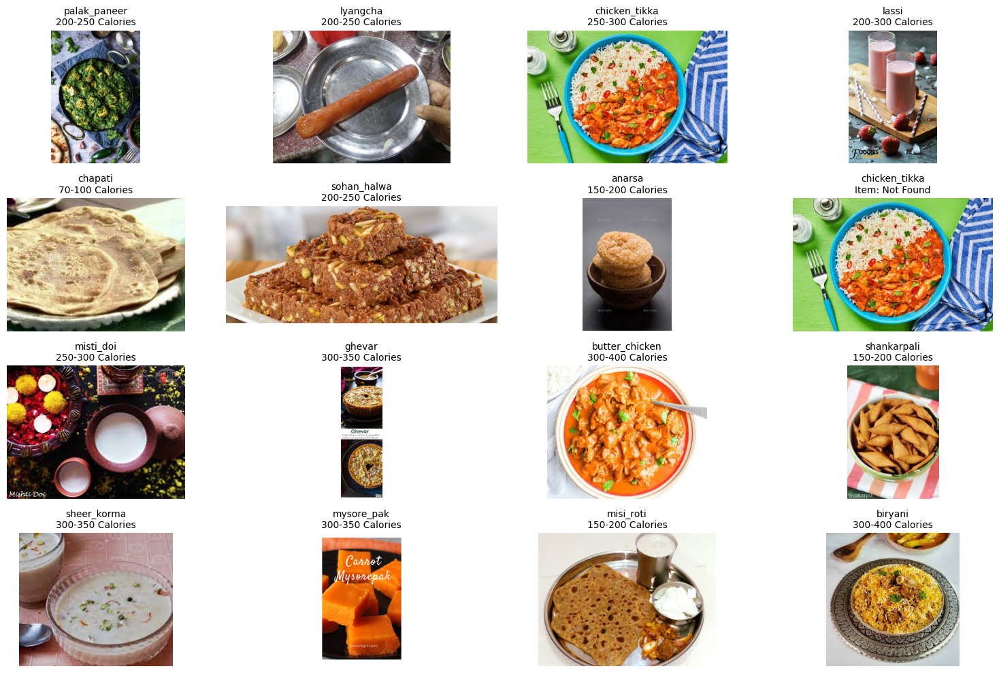

In [25]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pandas as pd

fig = plt.figure(figsize=(16, 10))
subplot_counter = 1

num_rows = 4
num_cols = 4

for cls in classes:

    class_files = [os.path.join(dataset_dir, cls, file) for file in os.listdir(os.path.join(dataset_dir, cls)) if file.endswith('.jpg')]

    if not class_files:
        continue

    img_path = class_files[0]
    img = mpimg.imread(img_path)

    ax = plt.subplot(num_rows, num_cols, subplot_counter)
    ax.imshow(img)
    ax.axis('off')

    # Find the item name for the given class
    matching_items = [k for k, v in item_to_class.items() if v == cls]

    if matching_items:
        item_name = matching_items[0]
        calorie_info = calorie_dataset[calorie_dataset['Item_Name'] == item_name]

        if not calorie_info.empty:
            calorie_text = f"{item_name}\n{calorie_info['Calorie'].values[0]} Calories"
        else:
            calorie_text = f"{item_name}\nCalories: Not Found"
    else:
        calorie_text = f"{cls}\nItem: Not Found"

    ax.set_title(calorie_text, fontsize=10)

    subplot_counter += 1

    if subplot_counter > num_rows * num_cols:
        break

plt.tight_layout()
plt.show()


In [26]:
import os
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pandas as pd
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import load_model
from tensorflow.keras.applications.resnet50 import preprocess_input

In [27]:
dataset_dir = '/content/Indian Food Images/Indian Food Images'

calorie_dataset_path = '/content/my_dataset.csv'


In [28]:
calorie_dataset = pd.read_csv(calorie_dataset_path)


model_path = '/content/food_model.h5'
model = load_model(model_path)

In [29]:
def preprocess_image(img_path, target_size=(224, 224)):
    img = load_img(img_path, target_size=target_size)
    img_array = img_to_array(img)
    img_array = preprocess_input(img_array)
    return img_array


In [30]:
num_samples = 1

fig = plt.figure(figsize=(16, 10))
subplot_counter = 1
classes = [subdir for subdir in os.listdir(dataset_dir) if os.path.isdir(os.path.join(dataset_dir, subdir))]


<Figure size 1600x1000 with 0 Axes>

1/1 [==============================] - 0s 118ms/step
Predicted Item: chhena_kheeri
Calories: 200-250


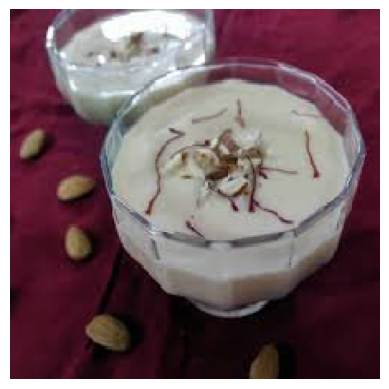

In [135]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
import numpy as np
import pandas as pd

model = load_model('/content/food_model.h5')

calorie_dataset = pd.read_csv('/content/my_dataset.csv')

dataset_dir = '/content/Indian Food Images/Indian Food Images'

classes = [d for d in os.listdir(dataset_dir) if os.path.isdir(os.path.join(dataset_dir, d))]

class_dir = os.path.join(dataset_dir, classes[59])
image_files = [f for f in os.listdir(class_dir) if f.endswith('.jpg')]

img_path = os.path.join(class_dir, image_files[15])

img = image.load_img(img_path, target_size=(224, 224))
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array /= 255.0

predicted_class_prob = model.predict(img_array)[0]
predicted_class_idx = np.argmax(predicted_class_prob)
predicted_class_name = classes[predicted_class_idx]

calorie_info = calorie_dataset[calorie_dataset['Item_Name'].str.lower() == predicted_class_name.lower()]

print(f"Predicted Item: {predicted_class_name}")
if not calorie_info.empty:
    print(f"Calories: {calorie_info['Calorie'].values[0]}")
else:
    print("Calories: Not Found")

plt.imshow(img)
plt.axis('off')
plt.show()